In [4]:
from datetime import datetime
import time
import os
import copy
import numpy as np
import pandas as pd
import cv2
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets, models, transforms
from sklearn.model_selection import train_test_split, KFold

from tqdm import tqdm
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.express as px
from zipfile import ZipFile
import albumentations as A
from albumentations.pytorch import ToTensorV2
from torchmetrics import Accuracy
import timm
from ASL.src.loss_functions.losses import AsymmetricLossOptimized

In [5]:
class CFG:
    seed = 0
    model_name = 'efficientnet_b4'
    pretrained = True
    img_width = 384
    img_height = 256
    batch_size = 32
    n_epochs = 10
    n_folds = 5
    drop_rate = 0.4
    train_size = 0.85
    device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

np.random.seed(CFG.seed)

# IMG_WIDTH, IMG_HEIGHT = 256, 170
# IMG_WIDTH, IMG_HEIGHT = 384, 256
# IMG_WIDTH, IMG_HEIGHT = 512, 342
# IMG_WIDTH, IMG_HEIGHT = 640, 426

In [7]:
images_folder = '/hy-tmp/Enderfga/plant_dataset/train/images'
df = pd.read_csv('/hy-tmp/Enderfga/plant_dataset/train/train_label.csv')
df.head()

,Unnamed: 0,images,labels
0,0,f4e1de628984e9d4.jpg,healthy
1,1,ae8c83b6a64554e7.jpg,rust
2,2,ad2fd0249f92351b.jpg,scab frog_eye_leaf_spot
3,3,b34c524efdb39109.jpg,powdery_mildew
4,4,8d66329bc5a6512f.jpg,powdery_mildew


In [8]:
list(df['labels'].value_counts().keys())

['scab',
 'healthy',
 'frog_eye_leaf_spot',
 'rust',
 'complex',
 'powdery_mildew',
 'scab frog_eye_leaf_spot',
 'scab frog_eye_leaf_spot complex',
 'frog_eye_leaf_spot complex',
 'rust frog_eye_leaf_spot',
 'rust complex',
 'powdery_mildew complex']

In [9]:
all_labels = np.unique([ lbl for label in df['labels'].value_counts().keys() for lbl in label.split(' ') ])
all_labels

array(['complex', 'frog_eye_leaf_spot', 'healthy', 'powdery_mildew',
       'rust', 'scab'], dtype='<U18')

In [10]:
data = pd.DataFrame(columns=['label', 'count'])
for lbl in all_labels:
    count = df[df['labels'].str.contains(lbl)].count()[0]
    data = data.append({'label': lbl, 'count': count}, ignore_index=True)

display(data)

,label,count
0,complex,418
1,frog_eye_leaf_spot,849
2,healthy,895
3,powdery_mildew,240
4,rust,418
5,scab,1073


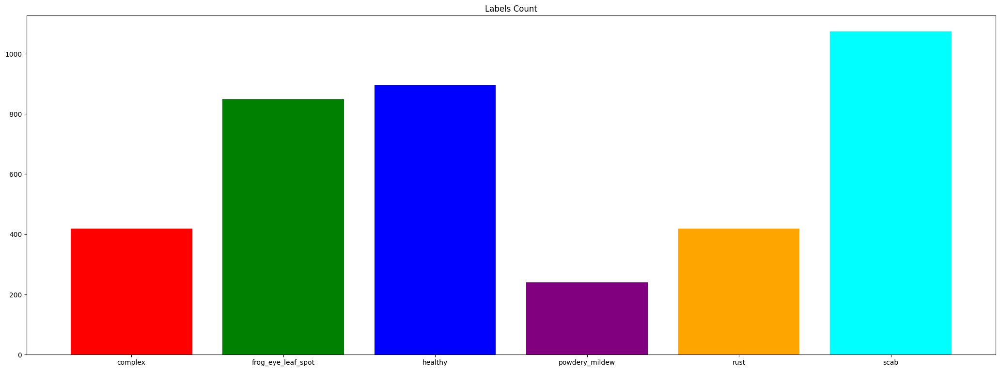

In [11]:
fig = plt.figure(figsize=(20, 7))
ax = fig.add_axes([0, 0, 1, 1])
ax.bar(data['label'], data['count'], color=['red', 'green', 'blue', 'purple', 'orange', 'cyan'])
plt.title('Labels Count')
plt.show()

In [12]:
def norm(img):
    img = np.array(img)
    img = img.astype(np.float32)
    img -= img.min()
    img /= img.max()
    return img

In [16]:
def show_samples(df, class_name, path):
    plt.figure(figsize=(20, 10))

    labeled_only = df[df.labels==class_name]
    for i in range(min(len(labeled_only), 8)):
        img_name = labeled_only.iloc[i].images
        plt.subplot(3, 4, i + 1)
        plt.title(class_name)
        plt.axis('off')
        img_path = os.path.join(path, img_name)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (CFG.img_width, CFG.img_height), cv2.INTER_AREA)
        plt.imshow(norm(img))
    plt.tight_layout()
    plt.show()

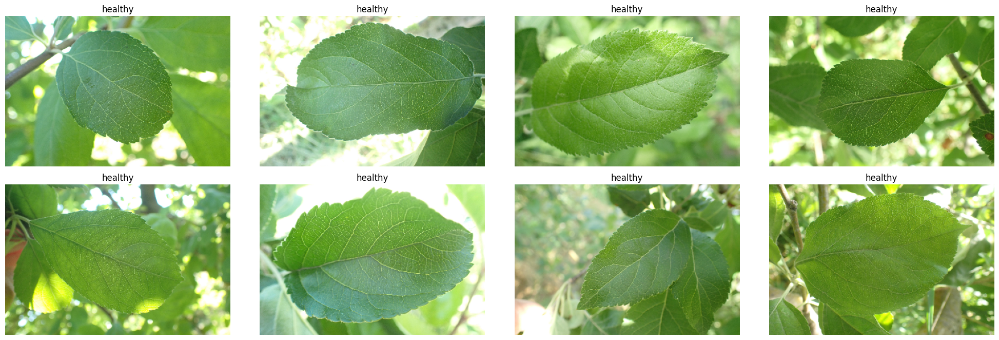

In [17]:
show_samples(df, 'healthy', images_folder)

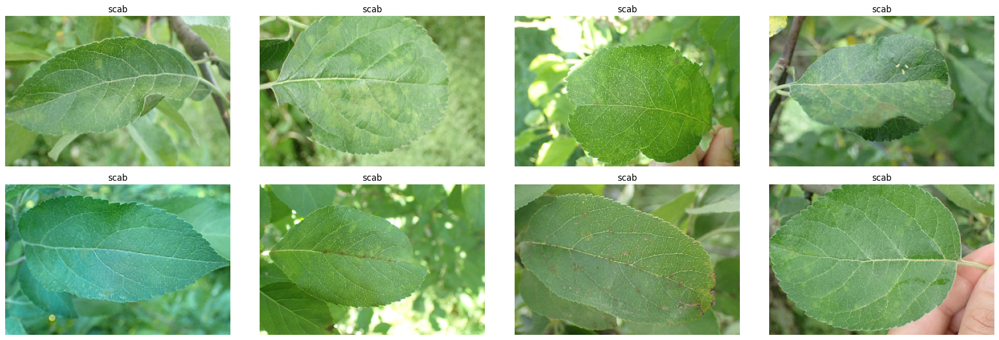

In [18]:
show_samples(df, 'scab', images_folder)

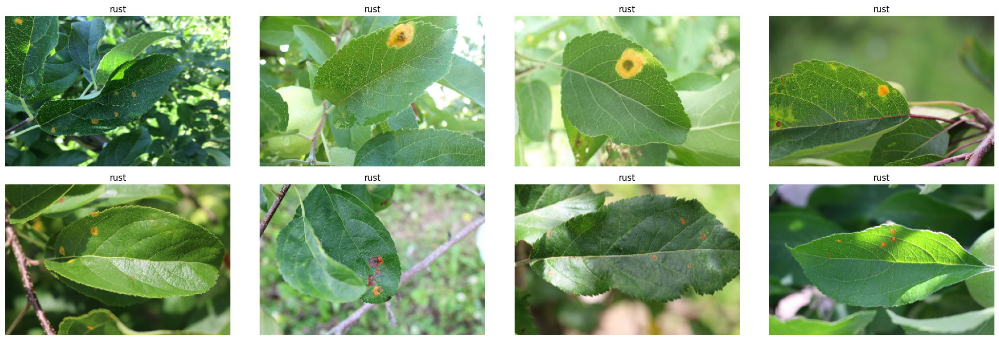

In [19]:
show_samples(df, 'rust', images_folder)

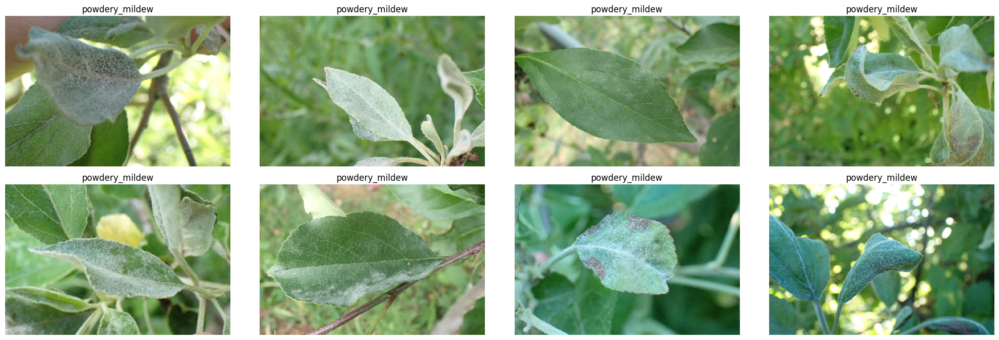

In [20]:
show_samples(df, 'powdery_mildew', images_folder)

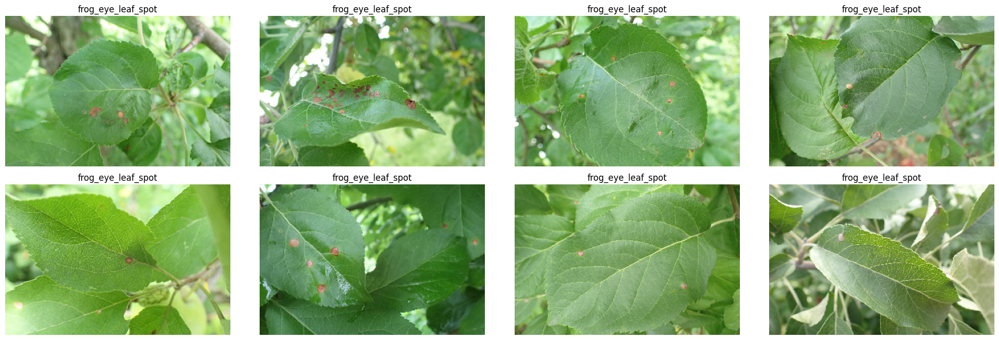

In [21]:
show_samples(df, 'frog_eye_leaf_spot', images_folder)

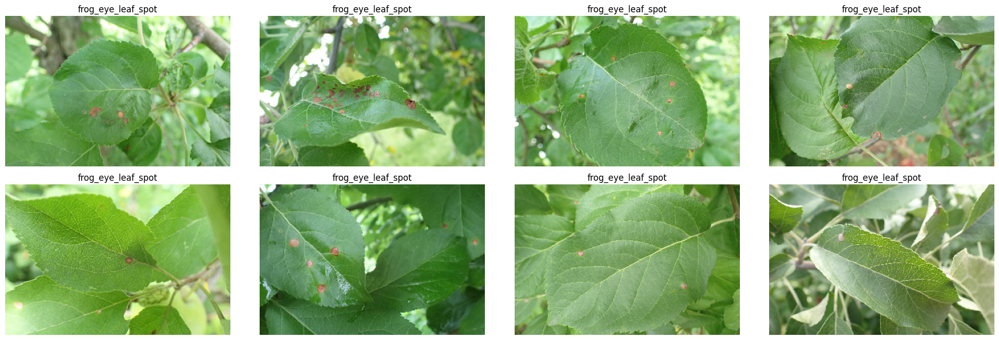

In [22]:
show_samples(df, 'frog_eye_leaf_spot', images_folder)

In [26]:
train_transformations = A.Compose([
                            A.HueSaturationValue(p=0.5),
                            A.Flip(p=0.5),
                            A.HorizontalFlip(p=0.5),
                            A.ShiftScaleRotate(p=0.5, shift_limit=(-0.1, 0.3), scale_limit=(-0.1, 0.6), rotate_limit=(-90, 90), interpolation=0, border_mode=2),
                            A.RandomBrightnessContrast(p=0.5, brightness_limit=(-0.2, 0.2), contrast_limit=(-0.2, 0.2)),
                            A.OneOf([
                                A.Blur(p=0.7),
                                A.GaussNoise(p=0.7, var_limit=(100, 400)),
                                A.MotionBlur(p=0.7),
                                A.ISONoise(p=0.7),
                            ], p=0.5),
                            A.OneOf([
                                A.GridDropout(ratio=0.3, p=0.5),
                                # A.CoarseDropout(p=0.5, max_holes=80, min_holes=50, max_height=50, max_width=50, min_height=8, min_width=8),
                                A.CoarseDropout(p=0.5, max_holes=40, max_height=20, max_width=20, min_holes=8, min_height=8, min_width=8),
                            ], p=0.5),
                            A.Normalize(
                                mean=[0.485, 0.456, 0.406],
                                std=[0.229, 0.224, 0.225],
                            ),
                            ToTensorV2(),
])

valid_transformations = A.Compose([
                            A.Normalize(
                                mean=[0.485, 0.456, 0.406],
                                std=[0.229, 0.224, 0.225],
                            ),
                            ToTensorV2(),
])

In [27]:
def show_augmentation(img_name, augmentation):
    img_path = os.path.join(images_folder, img_name)

    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    img = cv2.resize(img, (CFG.img_width, CFG.img_height), cv2.INTER_AREA)
    aug = A.Compose([augmentation])(image=img)['image']

    plt.figure(figsize=(15, 10))

    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title('Original Image')

    plt.subplot(1, 2, 2)
    plt.imshow(aug)
    plt.axis('off')
    plt.title(type(augmentation).__name__)

    plt.tight_layout()
    plt.show()

In [28]:
_img_name = df.images[0]
_img_name

'f4e1de628984e9d4.jpg'

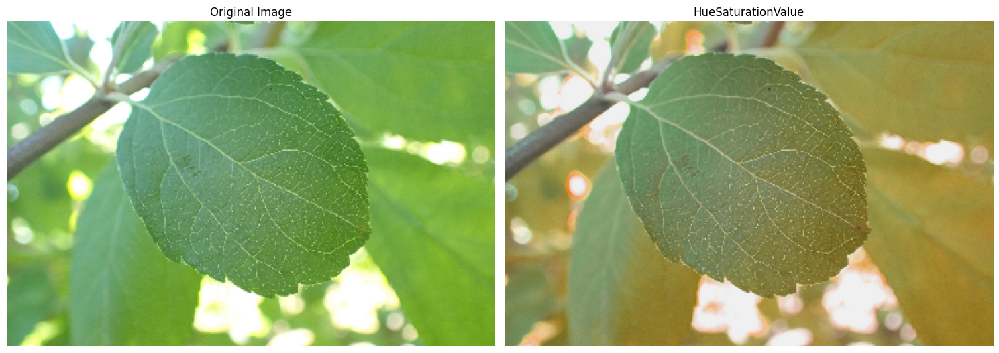

In [29]:
show_augmentation(_img_name, A.HueSaturationValue(p=1))

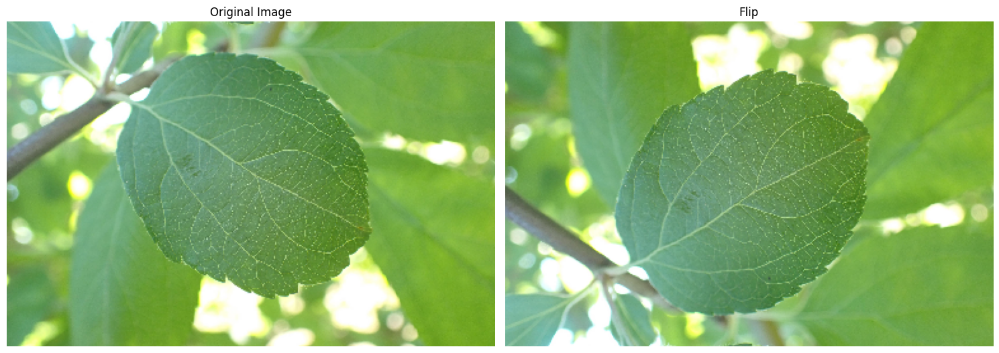

In [30]:
show_augmentation(_img_name, A.Flip(p=1))

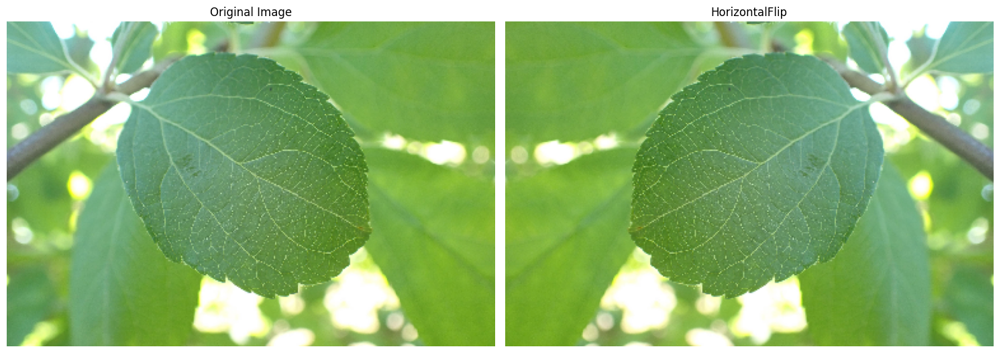

In [31]:
show_augmentation(_img_name, A.HorizontalFlip(p=1))

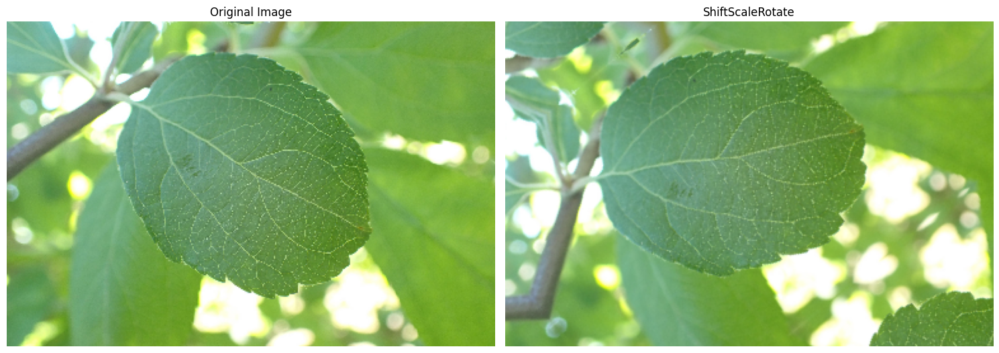

In [32]:
show_augmentation(_img_name, A.ShiftScaleRotate(p=1))

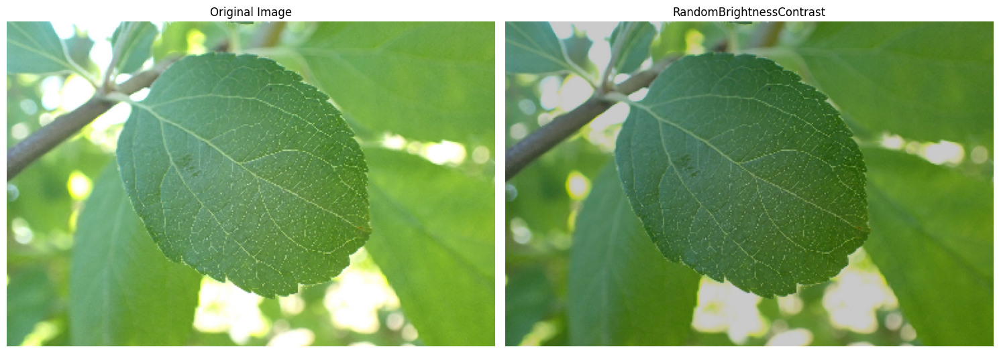

In [33]:
show_augmentation(_img_name, A.RandomBrightnessContrast(p=1, brightness_limit=(-0.2, 0.2), contrast_limit=(-0.2, 0.2)))

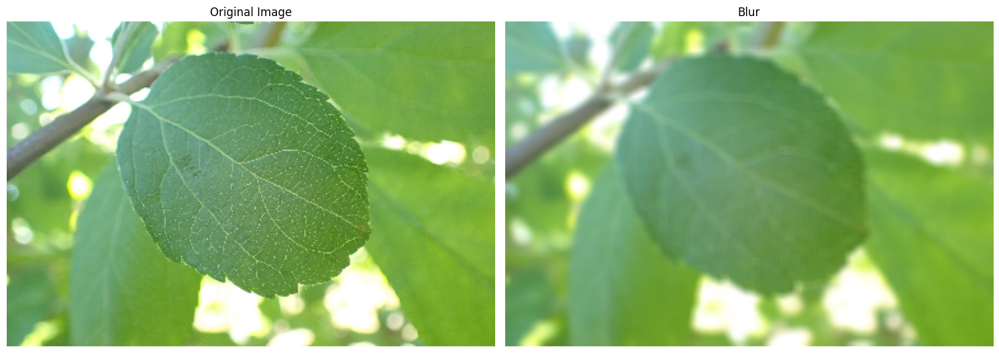

In [34]:
show_augmentation(_img_name, A.Blur(p=1))

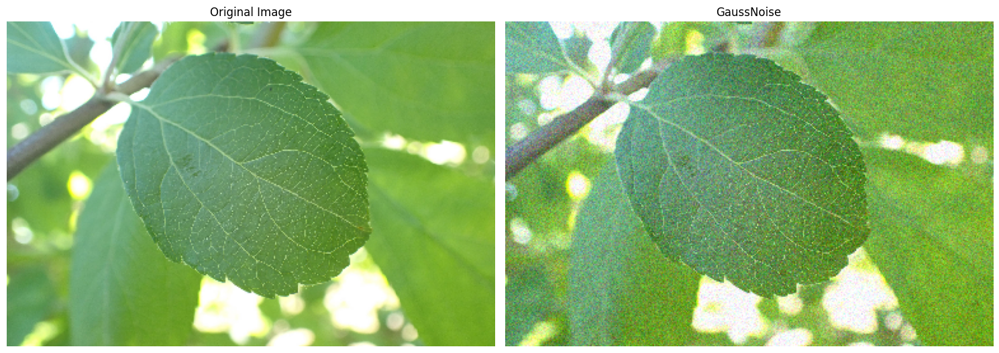

In [35]:
show_augmentation(_img_name, A.GaussNoise(p=1, var_limit=(300, 400)))

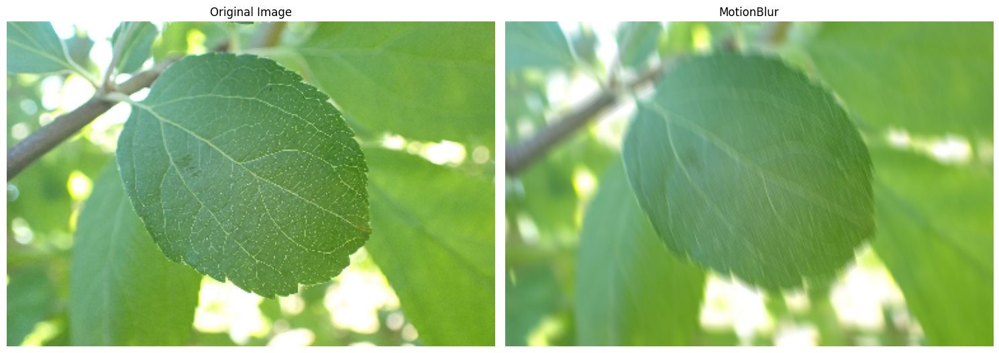

In [41]:
show_augmentation(_img_name, A.MotionBlur(p=1, blur_limit=(11, 21)))

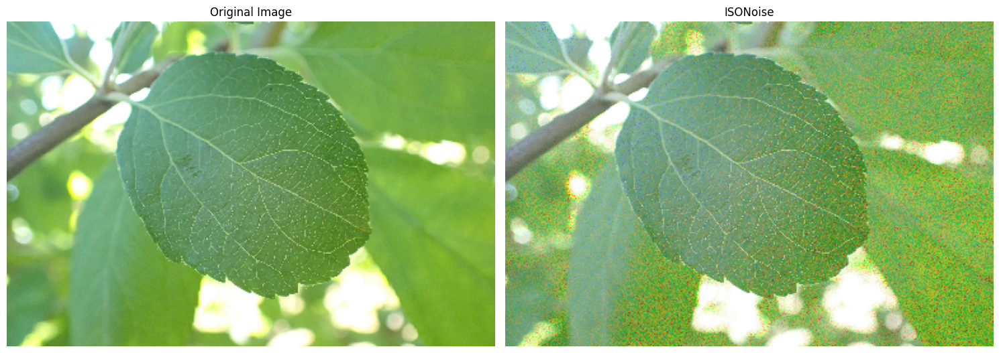

In [38]:
show_augmentation(_img_name, A.ISONoise(p=1, color_shift=(0.1, 0.5)))

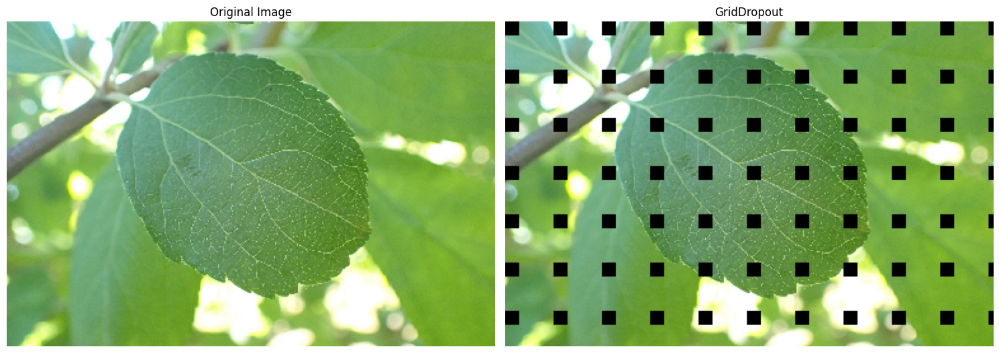

In [39]:
show_augmentation(_img_name, A.GridDropout(p=1, ratio=0.3))

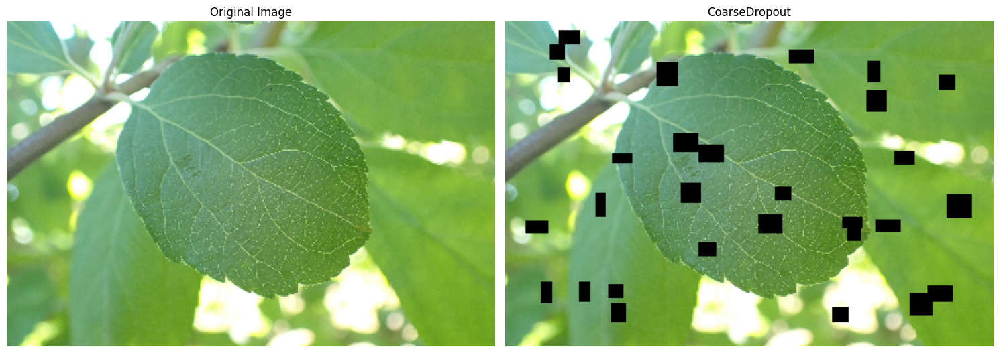

In [40]:
show_augmentation(_img_name, A.CoarseDropout(p=1, max_holes=40, max_height=20, max_width=20, min_holes=8, min_height=8, min_width=8))